# POTATO LEAF DISEASE



# Installation

In [ ]:
!pip install tensorflow
!pip install keras
!pip install Keras-Preprocessing
!pip install opencv-python
!pip install scikeras

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 1.5 MB/s eta 0:00:00


#Importing Libraries

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image_dataset_from_directory
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam, Adamax
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout, BatchNormalization
from tensorflow.keras import regularizers
from tensorflow.keras.models import Model
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import json

#Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Read the data

In [ ]:
# Update the path to point to your dataset in Google Drive
path = '/content/drive/MyDrive/Hoverin-data/color'

# Load the dataset
train_ds , test_ds = keras.utils.image_dataset_from_directory(
    path,
    image_size=(224, 224),
    batch_size=32,
    seed=123,
    validation_split=.2,
    subset='both'
)


Found 5037 files belonging to 9 classes.
Using 4030 files for training.
Using 1007 files for validation.


In [ ]:
# E:\Hoverin\DataSet\Potato\color\Potato___Early_blight

# Classes in the training dataset

In [ ]:
classes = train_ds.class_names
classes

['Bacteria',
 'Fungi',
 'Nematode',
 'Pest',
 'Phytopthora',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Virus']

# Visualize some images

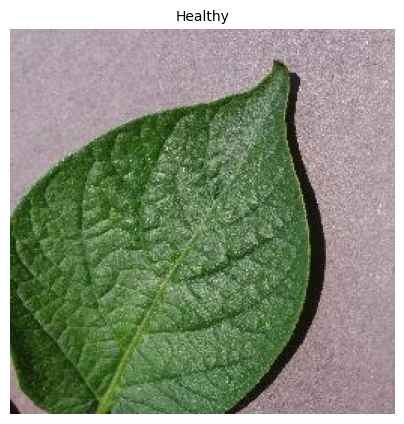

In [ ]:
# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Potato___healthy'

# List all files in the directory
files = os.listdir(directory_path)

# Select the first image in the directory (you can modify this as needed)
image_path = os.path.join(directory_path, files[0])

# Load the image using PIL
image = Image.open(image_path)

# Convert PIL image to NumPy array
image_np = np.array(image)

# Display the image
plt.figure(figsize=(5, 5))
plt.imshow(image_np)
plt.title('Healthy', size=10)
plt.axis('off')
plt.show()


## Healthy leaf

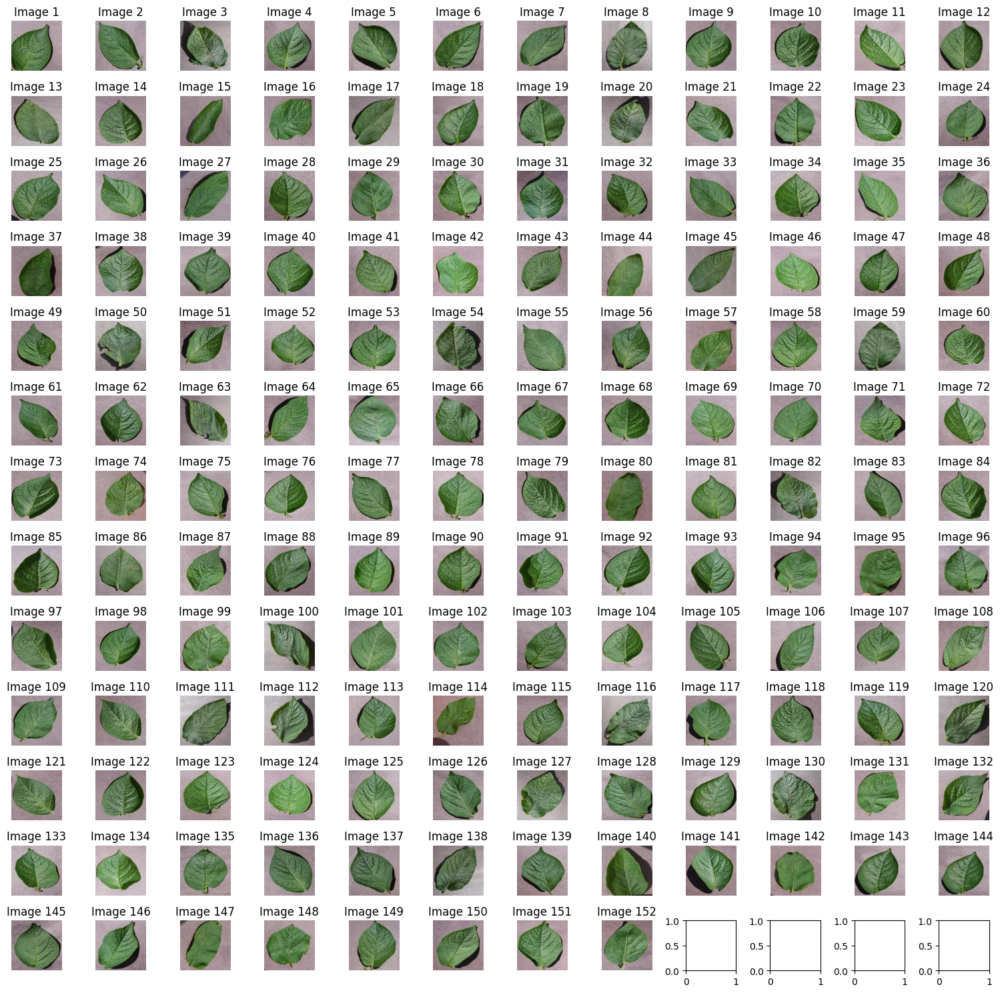

In [ ]:
from PIL import Image
import os

# Specify the path to the directory containing healthy images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Potato___healthy'

# List all files in the directory
files = os.listdir(directory_path)

# Set up a subplot for each image
num_images = len(files)
rows = int(np.ceil(np.sqrt(num_images)))
cols = int(np.ceil(num_images / rows))

# Create a figure and axis
fig, axs = plt.subplots(rows, cols, figsize=(15, 15))

# Iterate through files and display each image
for i, file in enumerate(files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles
plt.tight_layout()
plt.show()


##Early blight

<ipython-input-22-2bca189b00bf>:40: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


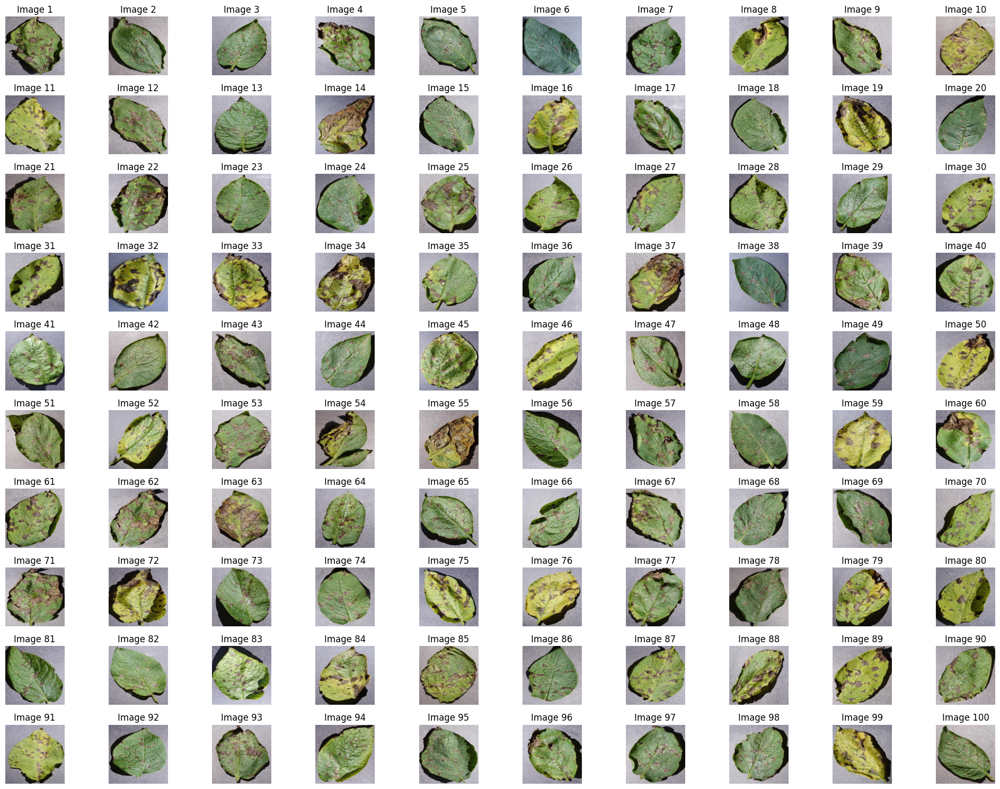

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Potato___Early_blight'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()

##Late blight

<ipython-input-23-ab398031442c>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


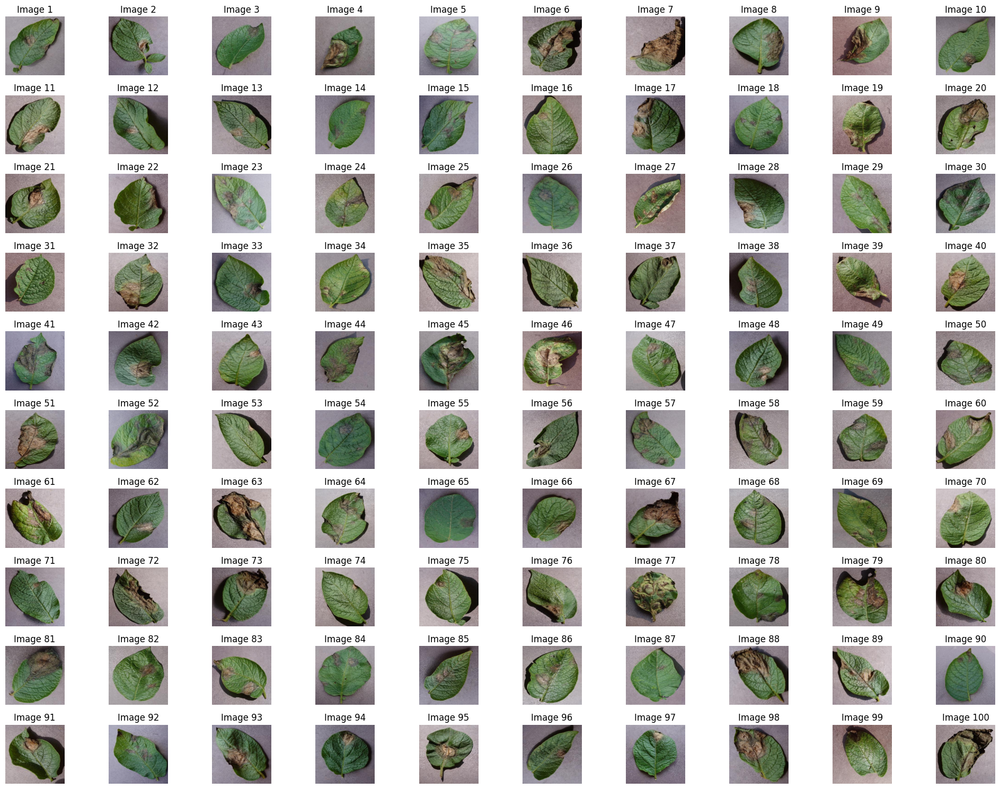

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Potato___Late_blight'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()


##Bacteria

<ipython-input-24-64a9f61693a2>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


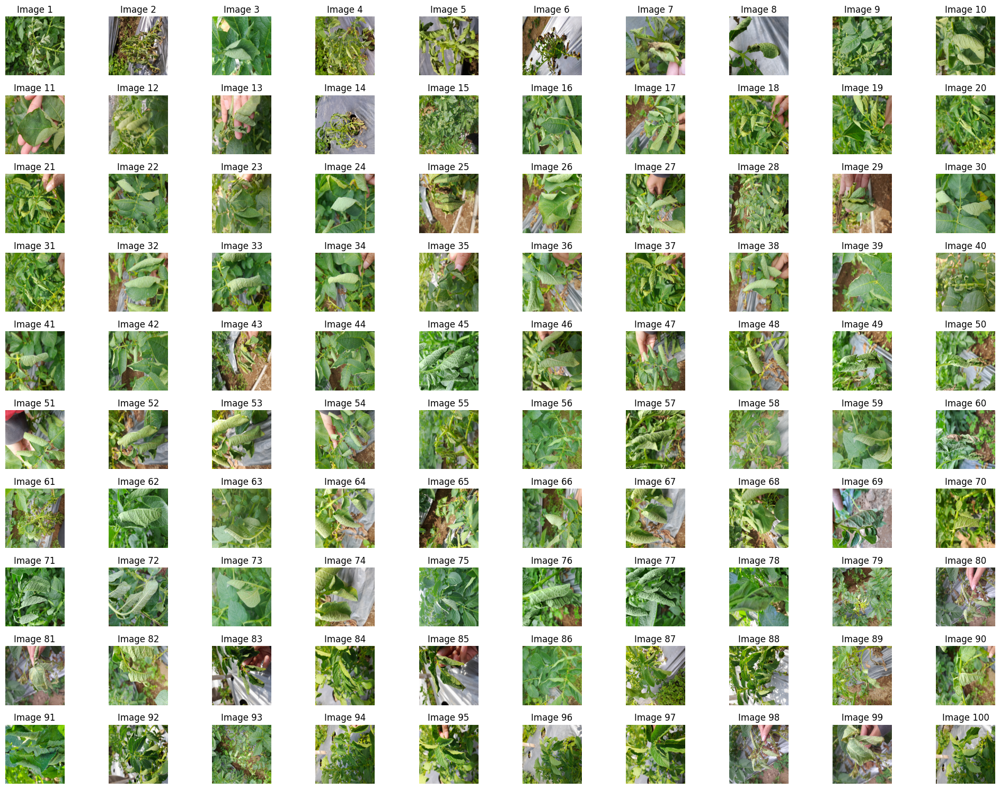

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Bacteria'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()


##Fungi

<ipython-input-25-a27f20c0b667>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


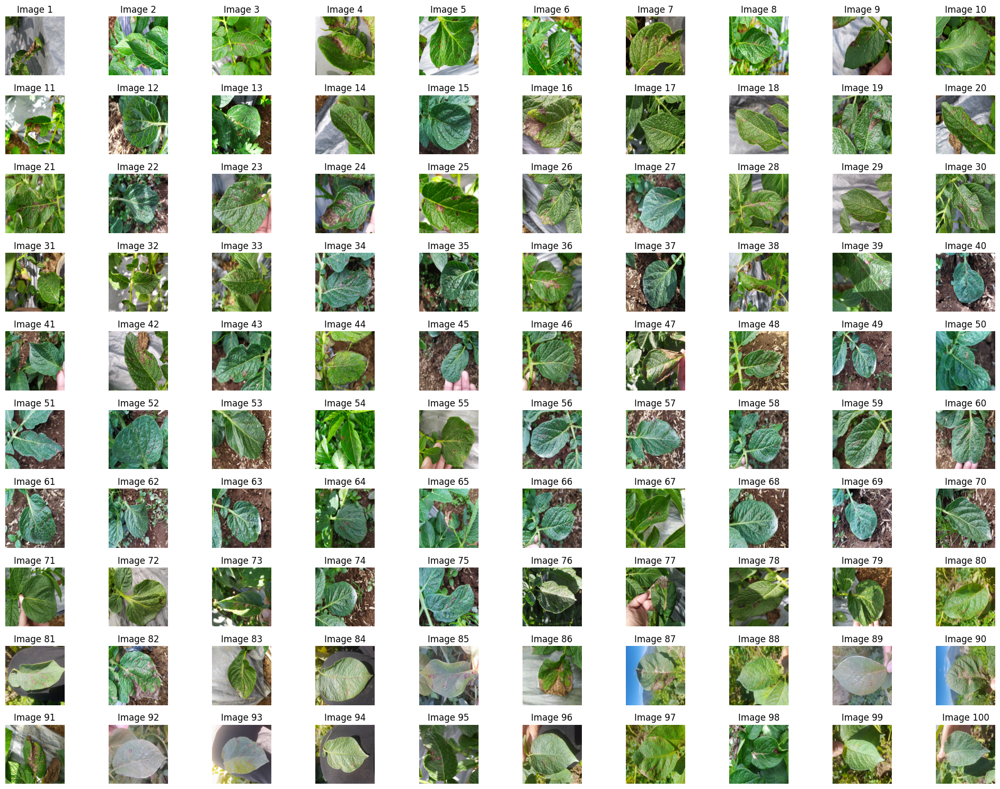

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Fungi'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()


##Nematode

<ipython-input-26-5b98f7ec180f>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


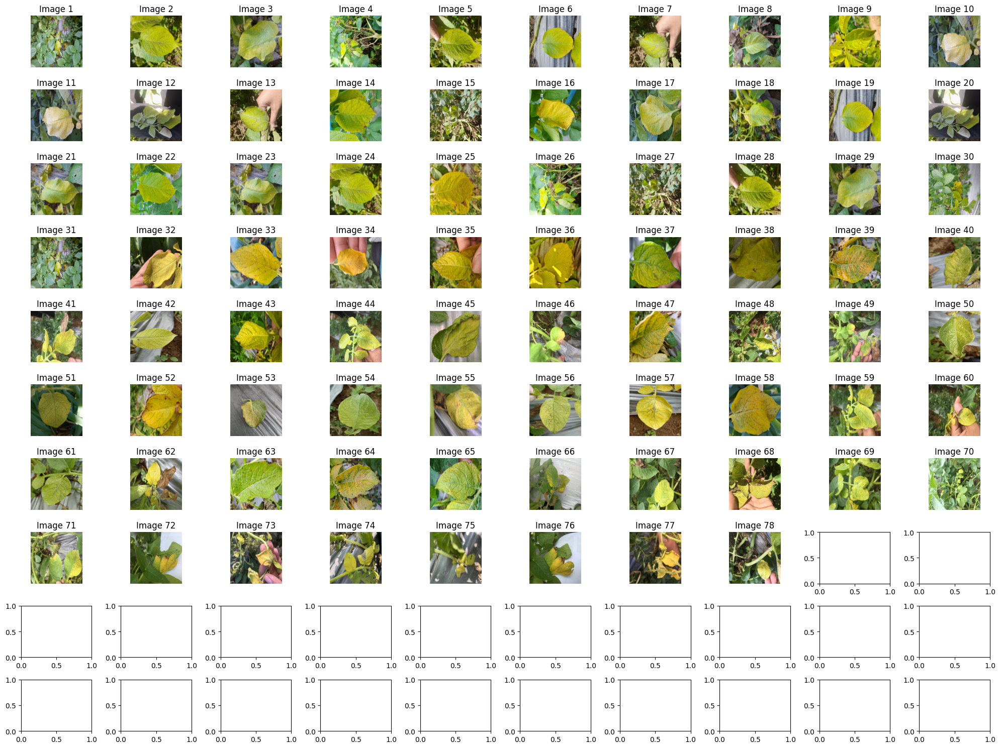

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Nematode'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()

##Pest

<ipython-input-27-ab80bf7d495b>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


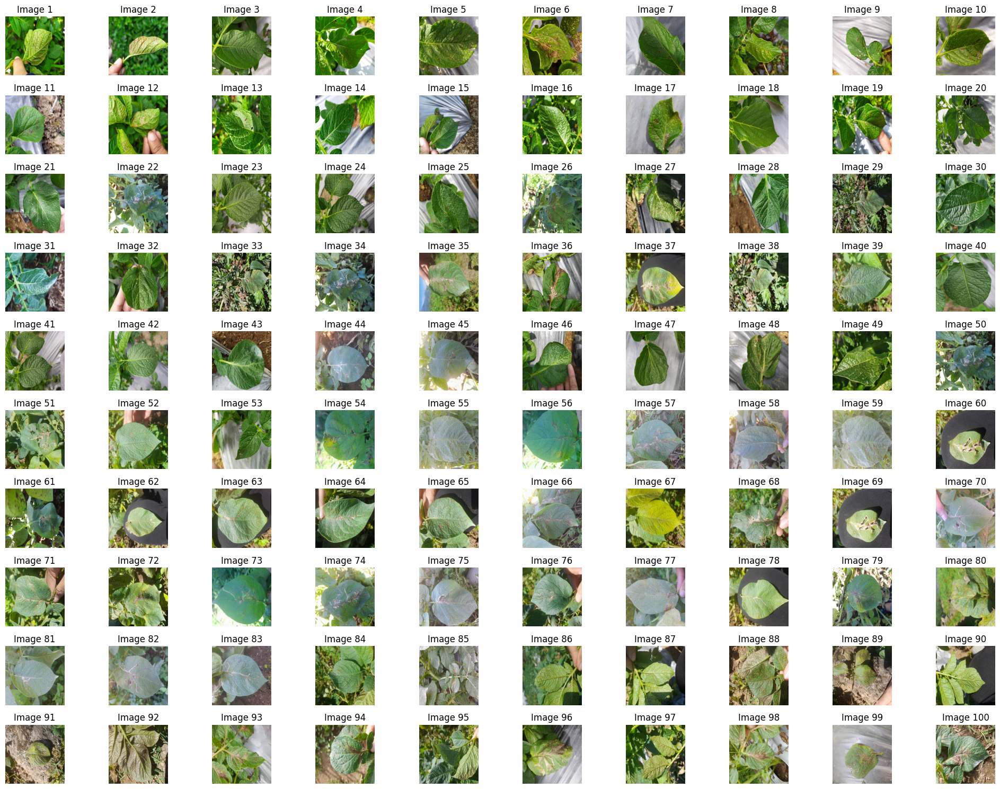

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Pest'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots+
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()

##Phytopthora

<ipython-input-28-6de60d958be4>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


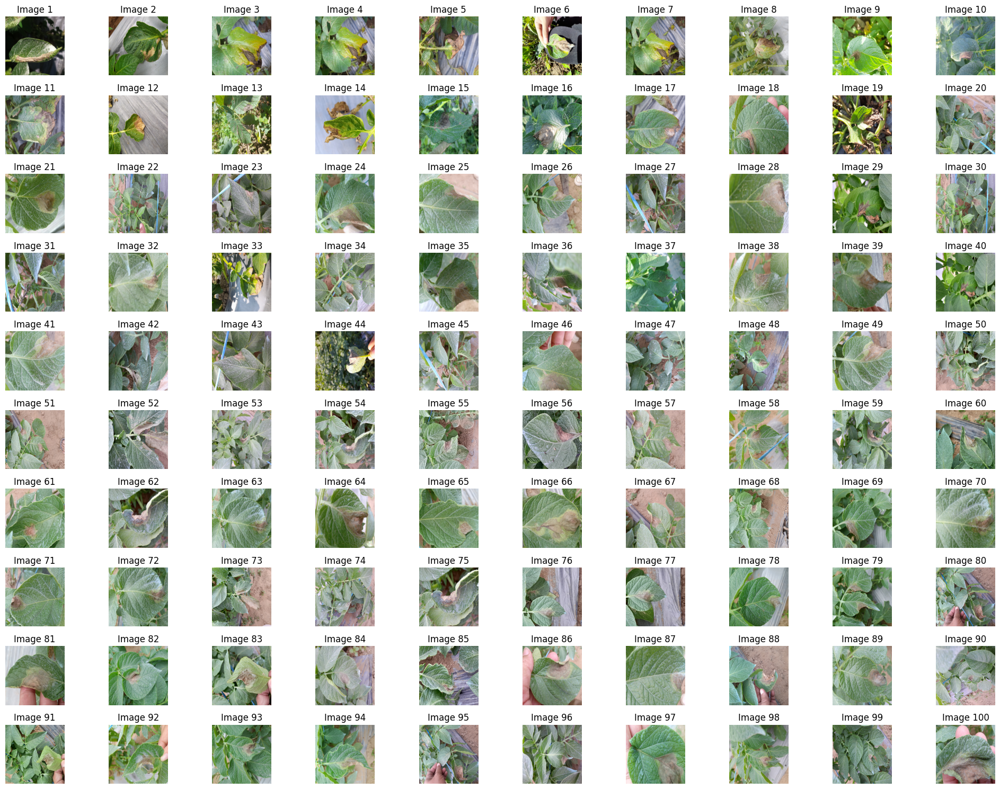

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Phytopthora'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()

##Virus

<ipython-input-29-dcc036c434ce>:41: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


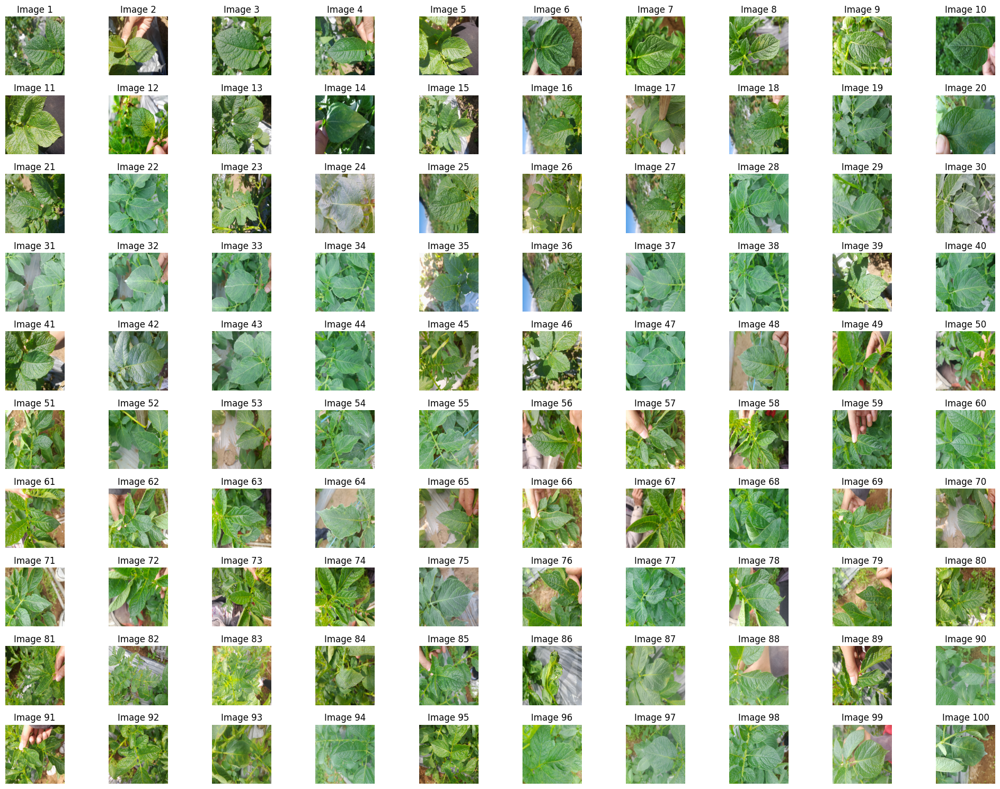

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import os

# Specify the path to the directory containing images
directory_path = '/content/drive/MyDrive/PotatoDataset/color/Virus'

# List only image files in the directory (assuming they have extensions like .jpg, .png, etc.)
image_files = [file for file in os.listdir(directory_path) if file.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Take only the first 100 image files
image_files = image_files[:100]

# Calculate the number of rows and columns needed for the 100 images
rows = 10  # Assuming 10 rows for a visually appealing grid
cols = 10

# Create a figure and axis with the specified number of subplots
fig, axs = plt.subplots(rows, cols, figsize=(20, 15), constrained_layout=True)

# Iterate through the first 100 image files and display each image
for i, file in enumerate(image_files):
    # Construct the full path to the image
    image_path = os.path.join(directory_path, file)

    # Load the image using PIL
    image = Image.open(image_path)

    # Convert PIL image to NumPy array
    image_np = np.array(image)

    # Display the image on the subplot
    row = i // cols
    col = i % cols
    axs[row, col].imshow(image_np)
    axs[row, col].set_title(f'Image {i+1}')
    axs[row, col].axis('off')

# Adjust layout to prevent clipping of titles and ensure a well-organized grid
plt.tight_layout()
plt.show()

# Build Neural Network (CNN)

In [ ]:
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Rescaling(scale=1/255, input_shape=(224, 224, 3)),

    keras.layers.Conv2D(32, (3, 3), activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.MaxPool2D((2, 2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(64, (3, 3), activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.MaxPool2D((2, 2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(64, (3, 3), activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.MaxPool2D((2, 2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(64, (3, 3), activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.MaxPool2D((2, 2)),
    keras.layers.Dropout(0.2),

    keras.layers.Conv2D(128, (3, 3), activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.MaxPool2D((2, 2)),

    # fully connected layers

    keras.layers.Flatten(),
    keras.layers.Dense(128, activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.Dense(64, activation=keras.layers.LeakyReLU(alpha=0.2)),
    keras.layers.Dense(38, activation='sigmoid')
])


##Compile the model

In [ ]:
#Compile the model with an optimizer, loss function, and metrics

model.compile(
    optimizer = 'adam' ,
    loss = 'sparse_categorical_crossentropy',
    metrics = 'accuracy'
)

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 111, 111, 32)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                   

# Training the model

In [ ]:
# prompt: code to increase learning rate  modify it for 20 epoch only

# Create a learning rate scheduler callback
lr_schedule = tf.keras.callbacks.LearningRateScheduler(
    lambda epoch: 1e-3 * 10**(epoch / 20)
)

# Train the model with the learning rate scheduler callback
history = model.fit(
    train_ds,
    validation_data=test_ds,
    epochs=10,
    callbacks=[lr_schedule]
)


Epoch 1/10
126/126 [==============================] - 1708s 13s/step - loss: 1.9333 - accuracy: 0.2883 - val_loss: 1.6597 - val_accuracy: 0.3674 - lr: 0.0010
Epoch 2/10
126/126 [==============================] - 44s 335ms/step - loss: 1.2187 - accuracy: 0.5330 - val_loss: 1.0737 - val_accuracy: 0.5978 - lr: 0.0011
Epoch 3/10
126/126 [==============================] - 39s 297ms/step - loss: 0.9558 - accuracy: 0.6203 - val_loss: 1.0656 - val_accuracy: 0.5372 - lr: 0.0013
Epoch 4/10
126/126 [==============================] - 39s 299ms/step - loss: 0.8355 - accuracy: 0.6767 - val_loss: 0.7650 - val_accuracy: 0.6812 - lr: 0.0014
Epoch 5/10
126/126 [==============================] - 40s 304ms/step - loss: 0.7668 - accuracy: 0.7015 - val_loss: 0.7510 - val_accuracy: 0.7080 - lr: 0.0016
Epoch 6/10
126/126 [==============================] - 42s 322ms/step - loss: 0.6704 - accuracy: 0.7377 - val_loss: 0.8766 - val_accuracy: 0.6514 - lr: 0.0018
Epoch 7/10
126/126 [==============================] 

In [ ]:
#fit the model

from tensorflow.keras.models import Model
history = model.fit(train_ds , epochs = 20)

In [ ]:
# code to save trained model

model.save('my_model.h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
model.save('my_my_model.keras')

# Model evaluation result

In [ ]:
# Accuracy and Loss Over Epochs

accuracy = history.history['accuracy']
loss = history.history['loss']
epochs = range(1, 21)

plt.plot(epochs, accuracy, label='Accuracy')
plt.plot(epochs, loss, label='Loss')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Accuracy / Loss')
plt.title('Training History')
plt.show()

### Accuracy on Training dataset

In [ ]:
result = model.evaluate(train_ds)

# Printing the result
print("Loss:", result[0])
print("Accuracy:", result[1])

126/126 [==============================] - 30s 221ms/step - loss: 0.6904 - accuracy: 0.7583
Loss: 0.690353274345398
Accuracy: 0.7583126425743103


### Accuracy on Test dataset


In [ ]:
result = model.evaluate(test_ds)

# Printing the result
print("Loss:", result[0])
print("Accuracy:", result[1])

32/32 [==============================] - 6s 196ms/step - loss: 0.9688 - accuracy: 0.6653
Loss: 0.9688124060630798
Accuracy: 0.6653426289558411


# Test Model Predictions

In [ ]:
# Preprocessing an image before passing it to a model for prediction

def img_to_pred(image):
  # Convert the image to a NumPy array
  image = image.numpy()
  # Add an extra dimension to the array
  image = tf.expand_dims(image,0)
  return image


Creating a subplot to visualize a batch of images from the test dataset and show their actual labels alongside the predicted labels


NameError: name 'classes' is not defined

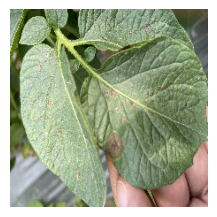

In [ ]:
plt.figure(figsize=(18, 18))
for images, labels in test_ds.take(1):
    for i in range(1, 19):
        plt.subplot(6, 3, i)
        plt.imshow(images[i-1].numpy().astype('uint32'))
        plt.axis('off')
        actual = classes[labels[i-1]]  # Corrected index
        predict = classes[np.argmax(model.predict(img_to_pred(images[i-1])))]  # Corrected index
        plt.title(f"actual : {actual}  \n predicted : {predict} ")


# Coverting output in json format

In [ ]:
# Save accuracy and loss history to a dictionary
history_data = {
    'epochs': list(range(1, 21)),
    'accuracy': history.history['accuracy'],
    'loss': history.history['loss']
}
history_data

{'epochs': [1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20],
 'accuracy': [0.28833746910095215,
  0.533002495765686,
  0.6203473806381226,
  0.6766749620437622,
  0.7014888525009155,
  0.7377170920372009,
  0.7397022247314453,
  0.7516129016876221,
  0.7836228013038635,
  0.766749382019043],
 'loss': [1.9332517385482788,
  1.2186692953109741,
  0.955836296081543,
  0.8355122208595276,
  0.7667666077613831,
  0.6703895330429077,
  0.6700567007064819,
  0.6479819416999817,
  0.5535500645637512,
  0.6362808346748352]}

In [ ]:
# Convert model evaluation results to a dictionary
train_evaluation = {
    'loss': result[0],
    'accuracy': result[1]
}

test_evaluation = {
    'loss': result[0],
    'accuracy': result[1]
}


In [ ]:
# Save the model summary to a dictionary
model_summary = {
    'model_summary': model.summary()
}


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 dropout (Dropout)           (None, 111, 111, 32)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                   

In [ ]:
# Convert the image predictions to a list of dictionaries
image_predictions = []
for images, labels in test_ds.take(1):
    for i in range(1, 19):
        actual = classes[labels[i-1]]
        predict = classes[np.argmax(model.predict(img_to_pred(images[i-1])))]
        image_predictions.append({
            'actual': actual,
            'predicted': predict
        })

1/1 [==============================] - 0s 43ms/step


In [ ]:
# Combine all results into a final dictionary
output_data = {
    'history': history_data,
    'train_evaluation': train_evaluation,
    'test_evaluation': test_evaluation,
    'model_summary': model_summary,
    'image_predictions': image_predictions
}

In [ ]:
# Convert the dictionary to JSON format
json_output = json.dumps(output_data, indent=4)

# Print or save the JSON output as needed
print(json_output)


{
    "history": {
        "epochs": [
            1,
            2,
            3,
            4,
            5,
            6,
            7,
            8,
            9,
            10,
            11,
            12,
            13,
            14,
            15,
            16,
            17,
            18,
            19,
            20
        ],
        "accuracy": [
            0.30248138308525085,
            0.4935483932495117,
            0.6121588349342346,
            0.6848635077476501,
            0.7193548679351807,
            0.751861035823822,
            0.7990074157714844,
            0.8287841081619263,
            0.8647642731666565,
            0.8771712183952332,
            0.9044665098190308,
            0.9235731959342957,
            0.9349876046180725,
            0.9439206123352051,
            0.9468982815742493,
            0.9513647556304932,
            0.9759305119514465,
            0.9692307710647583,
            0.9697270393371582,
          